## Trend Analysis - bookings.py
The following notebook will be used to explore bookings.py data trends that are beyond the scope and capabilities of ElasticSearch and Kibana.
The purpose of this exploration is to understand the potential correlation and impact of weather and covid cases on the bookings numbers for local gyms.


In [1]:
import os
import sys
import pandas as pd
import matplotlib.pyplot as plt
import utils.weather
BASE_DIR = os.path.dirname(os.path.dirname(
    os.path.dirname(os.path.abspath('../../'))))
sys.path.append(BASE_DIR)
import common.globals as glbs  # noqa
import common.common as common  # noqa
import config as config  # noqa



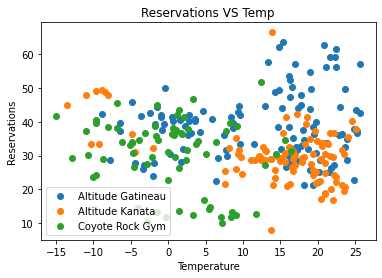

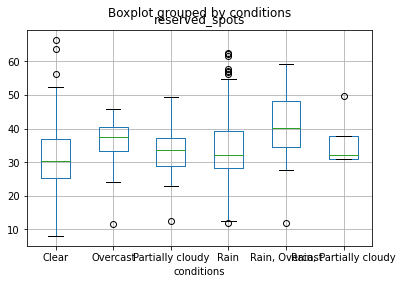

In [2]:

# Load bookings data as a pandas dataframe
bookings = common.load_bulk_json(os.path.join(glbs.ES_BULK_DATA, 'bookings.json'))
df = pd.DataFrame(bookings, columns=bookings[0].keys())

# Group rows and calc average for availablity metrics
metrics = ['availability','reserved_spots','capacity']
aggs = df.groupby(df.date)[metrics].mean()
# remove metrics from original so they can be replaced
df.drop(metrics, axis=1, inplace=True)
df.drop_duplicates(subset='date', keep='last', inplace=True)
df = df.merge(right=aggs, right_index=True, left_on=df.date, how='right')
# Resevations VS Temp
fig,ax = plt.subplots()
for k,d in df.groupby('location'):
    ax.scatter(d['temperature'], d['reserved_spots'], label=k)
plt.legend(loc=3)
# plt.grid(True)
plt.title("Reservations VS Temp")
plt.xlabel("Temperature")
plt.ylabel("Reservations")
plt.savefig(os.path.join(glbs.NOTEBOOK_DIR, 'reservations_vs_temp.png'))
plt.show()

# #Temp
# fig,ax = plt.subplots()
# for k,d in df.groupby('location'):
#     ax.scatter(d['conditions'], d['reserved_spots'], label=k)
# plt.legend(loc=4)
# # plt.grid(True)
# plt.title("Reservations VS Conditions")
# plt.xlabel("Conditions")
# plt.ylabel("Reservations")
# plt.savefig(os.path.join(glbs.NOTEBOOK_DIR, 'reservations_vs_conditions.png'))

# plt.show()

boxplot = df.boxplot(by='conditions',column='reserved_spots')
plt.savefig(os.path.join(glbs.NOTEBOOK_DIR, 'reservations_vs_condictions.png'))


# Processing descriptions with NLP
When analyzing data on projects, can we identify any trends in the words, and phrases that are used?

In [3]:
# Importing modules for NLP
import pandas as pd
import matplotlib.pyplot as plt
import multidict as multidict
import re
import spacy
from spacy import displacy
from wordcloud import WordCloud

ModuleNotFoundError: No module named 'multidict'

In [ ]:
sp = spacy.load('en_core_web_sm')

In [ ]:
# Code from the example in: https://amueller.github.io/word_cloud/auto_examples/frequency.html
def getFrequencyDictForText(sentence):
    fullTermsDict = multidict.MultiDict()
    tmpDict = {}
    # making dict for counting frequencies
    for text in sentence.split(" "):
        val = tmpDict.get(text, 0)
        tmpDict[text.lower()] = val + 1
    for key in tmpDict:
        fullTermsDict.add(key, tmpDict[key])
    return fullTermsDict

In [ ]:
# This function comes from: https://towardsdatascience.com/simple-wordcloud-in-python-2ae54a9f58e5
# Define a function to plot a word cloud
def plot_cloud(wordcloud):
    # Set figure size
    plt.figure(figsize=(40, 30))
    # Display image
    plt.imshow(wordcloud) 
    # No axis details
    plt.axis("off");

In [ ]:
# Load descriptions into spaCy 
def create_wordcloud(col, name, pos=None):
    '''
    :param df: Dataframe containing data to visualize
    :param col: Column name
    :param pos: Optional - spaCy part of speech (ADJ, NOUN, VERB ...)
    '''
    desc = ' '.join(col)
    content = sp(desc)
    lemma_desc = ''
    for token in content:
        if not pos == None:
            if not token.is_stop and not token.is_punct and token.pos_ == pos:
                lemma_desc += f'{token.lemma_} '
        else:
            if not token.is_stop and not token.is_punct :
                lemma_desc += f'{token.lemma_} '
    # Get the frequencies
    frequencies = getFrequencyDictForText(lemma_desc)
    # Create the word cloud (with random_state=1)
    lemma_cloud = WordCloud(width=750, height=500, random_state=1, collocations=False).generate_from_frequencies(frequencies)
    # Plot the word cloud
    plot_cloud(lemma_cloud)
    # Saving
    lemma_cloud.to_file(os.path.join(glbs.NOTEBOOK_DIR, f"wordcloud_{name}_{pos}.png".replace("_None", "").lower()))


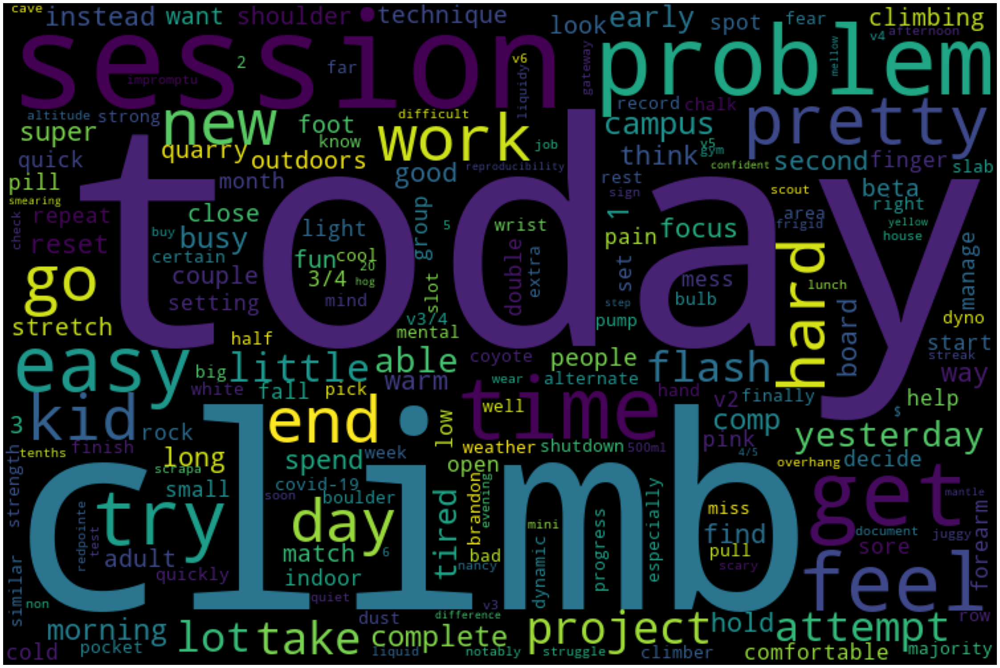

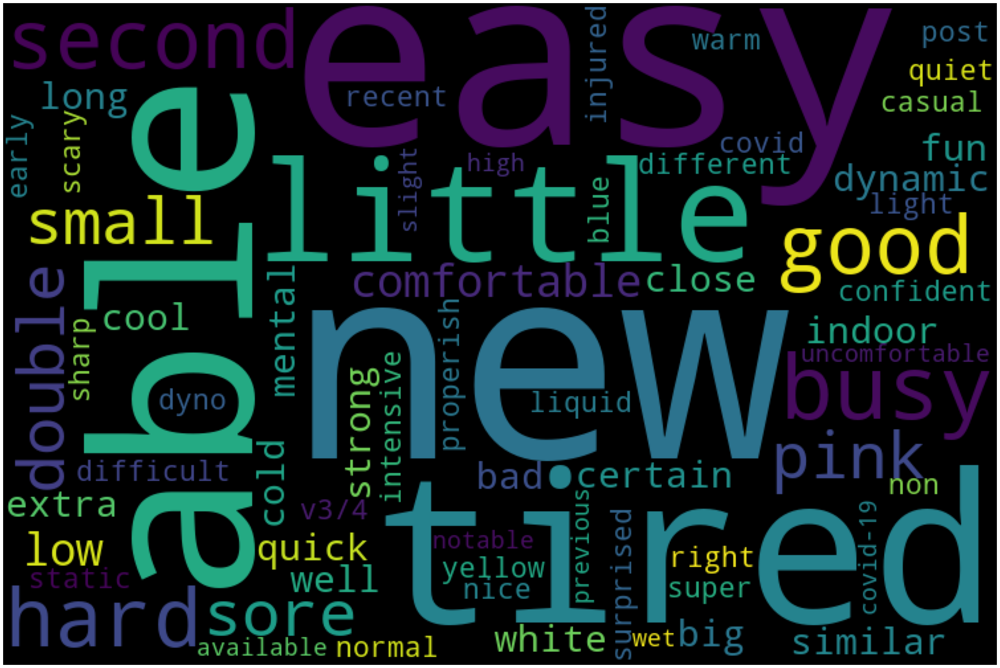

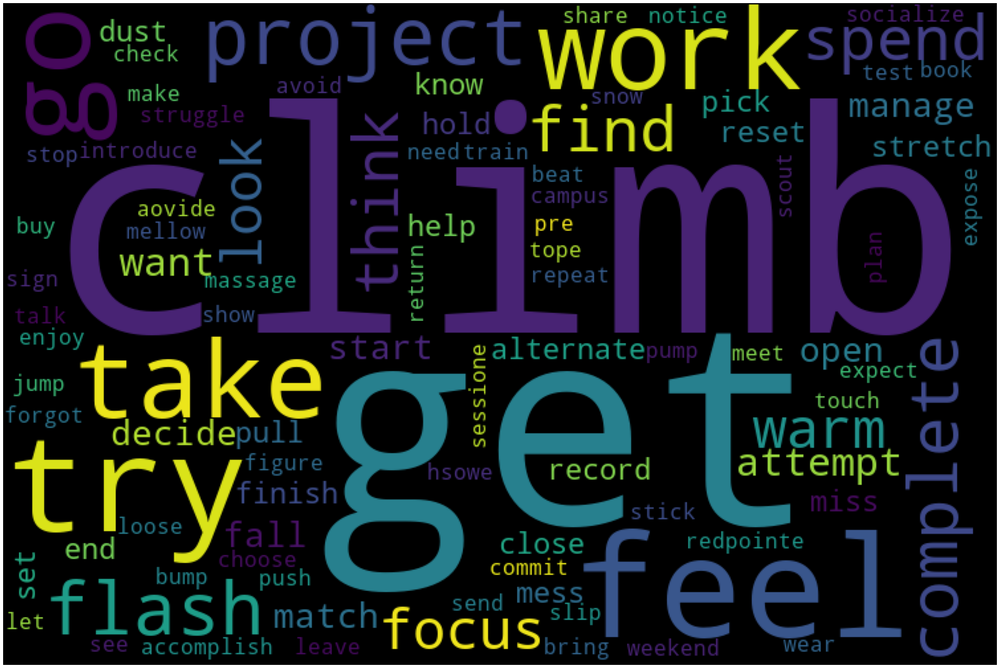

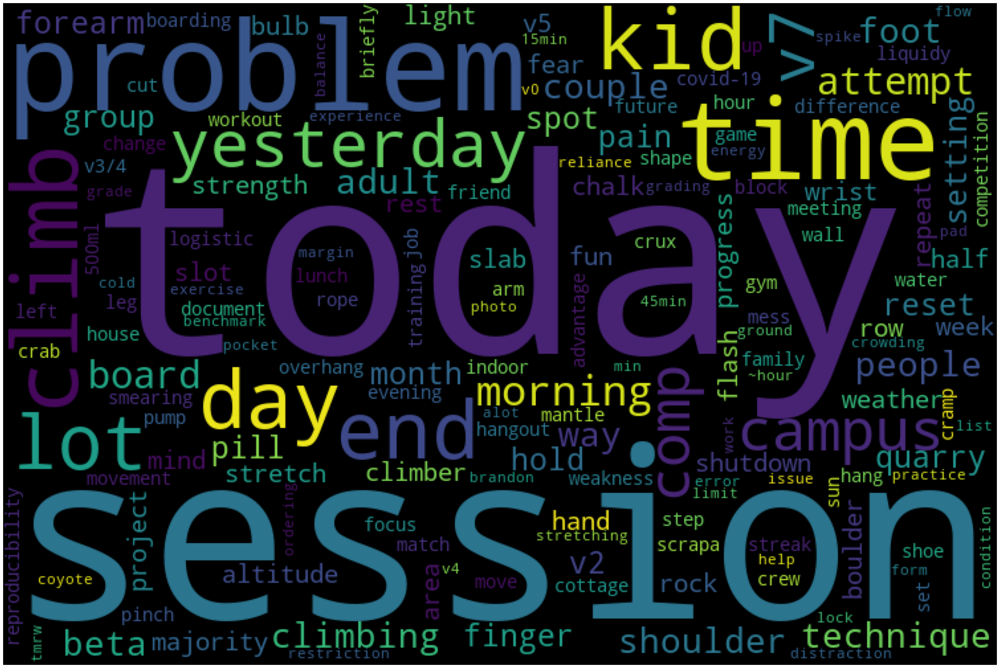

In [ ]:

# Load bookings data as a pandas dataframe
bookings = common.load_bulk_json(os.path.join(glbs.ES_BULK_DATA, 'sessions.json'))
df = pd.DataFrame(bookings, columns=bookings[0].keys())
df = df.where(pd.notnull(df), '')

# Creating wordcloud based on sessions descriptions
for pos in [None, 'ADJ', 'VERB', 'NOUN']:
    create_wordcloud(df['description'],'session_desc', pos=pos)


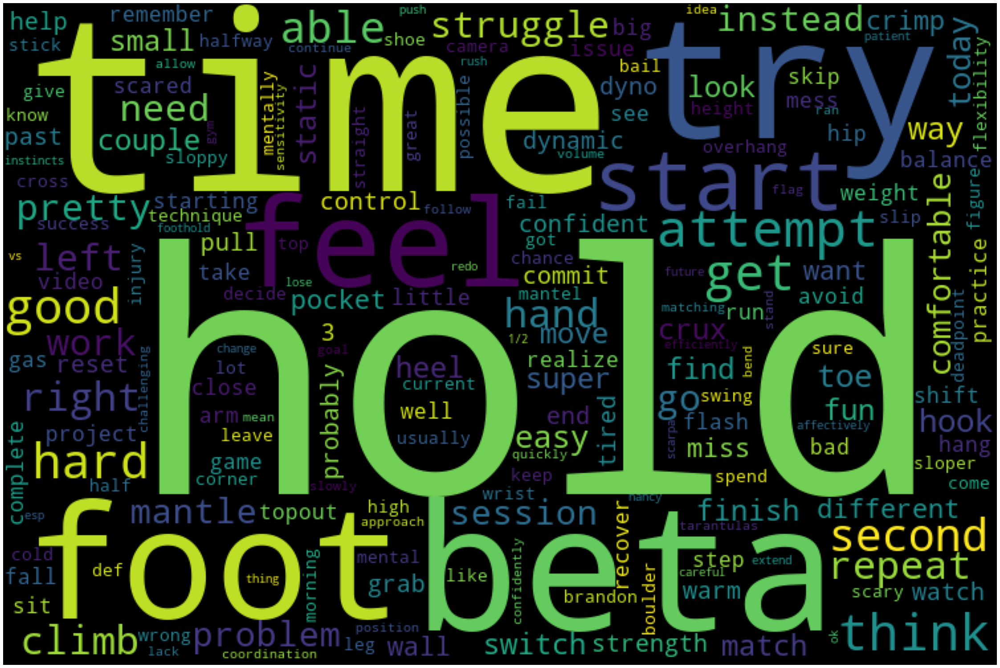

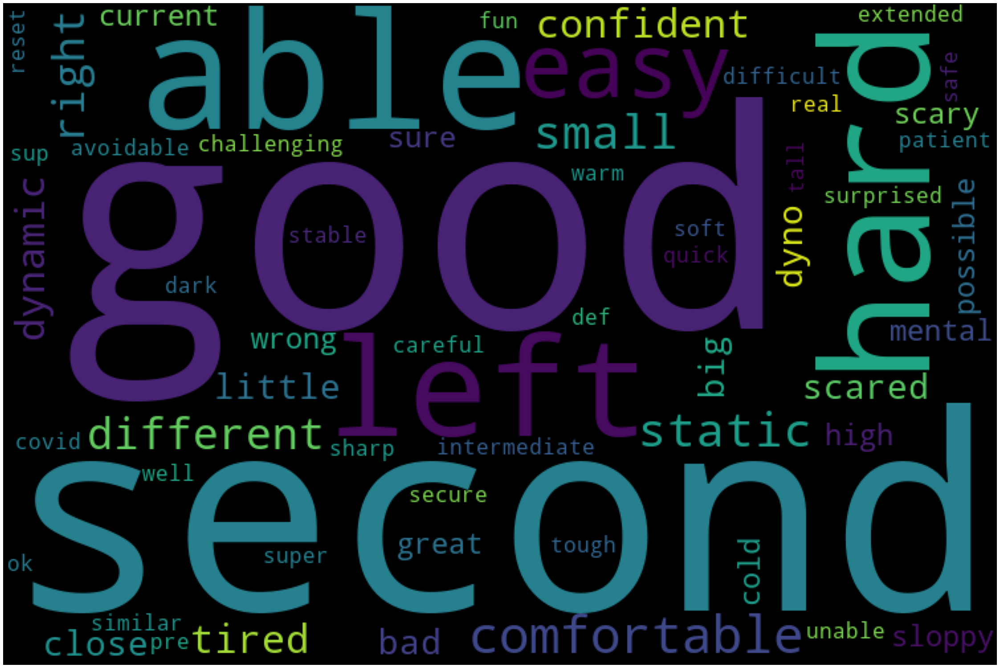

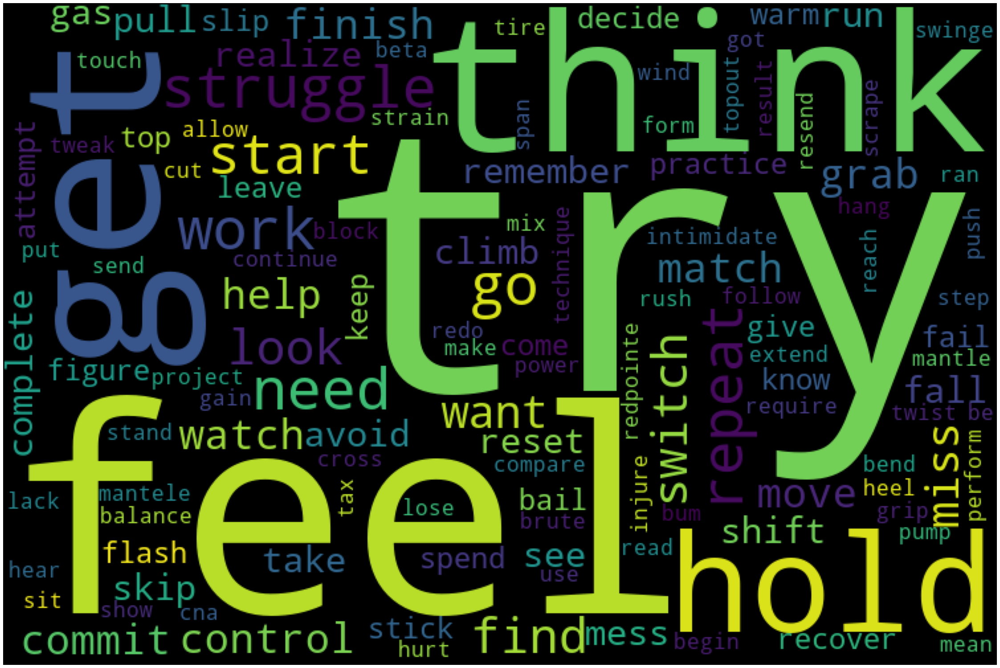

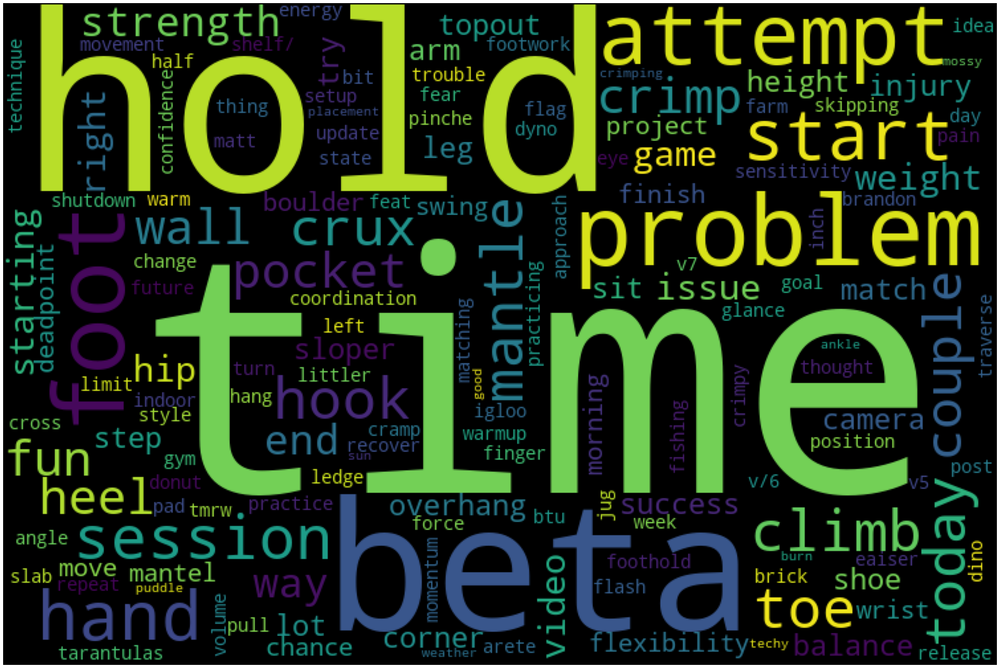

In [ ]:

# Load bookings data as a pandas dataframe
bookings = common.load_bulk_json(os.path.join(glbs.ES_BULK_DATA, 'projects.json'))
df = pd.DataFrame(bookings, columns=bookings[0].keys())
df = df.where(pd.notnull(df), '')

# Creating wordcloud based on sessions descriptions
for pos in [None, 'ADJ', 'VERB', 'NOUN']:
    create_wordcloud(df['notes'],'project_notes', pos=pos)
